# Notebook for Cell-Cell communication using `LIANA` and `Tensor-Cell2cell`

- **Developed by:** Srivalli Kolla

- **Modified by:** Srivalli Kolla

- **Date of creation:** 01 August, 2024 

- **Date of modification:** 01 August, 2024

**Würzburg Institute for Systems Immunology & Julius-Maximilian-Universität Würzburg**

# Importing Packages

In [2]:
import cell2cell as c2c
import liana as li
import os
import pandas as pd
import decoupler as dc 
import scanpy as sc
import anndata as ad
import numpy as np
import anndata
import scipy
import scipy.sparse as sp
from scipy.stats import shapiro
from scipy.sparse import issparse
from plotnine import theme, element_text
from collections import defaultdict

import plotnine as p9
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

from scipy.sparse import csr_matrix

/home/skolla/miniforge3/envs/liana_env/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
import logging
logging.disable(logging.WARNING) 
import warnings
warnings.filterwarnings('ignore')
# NOTE: to use CPU instead of GPU, set use_gpu = False
use_gpu = True

In [4]:
if use_gpu:
    import torch
    import tensorly as tl

    device = "cuda:1" if torch.cuda.is_available() else "cpu"
    if device == "cuda:1":
        tl.set_backend('pytorch')
else:
    device = "cpu"

device


'cuda:1'

In [5]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 300, color_map = 'magma', dpi_save = 300, vector_friendly = True, format = 'svg')

-----
anndata     0.10.8
scanpy      1.10.2
-----
PIL                 10.4.0
asttokens           NA
backcall            0.2.0
cell2cell           0.7.4
cffi                1.16.0
comm                0.2.2
cycler              0.12.1
cython_runtime      NA
dateutil            2.9.0
debugpy             1.8.3
decorator           5.1.1
decoupler           1.7.0
dill                0.3.8
docrep              0.3.2
exceptiongroup      1.2.2
executing           2.0.1
h5py                3.11.0
importlib_resources NA
ipykernel           6.29.5
jedi                0.19.1
joblib              1.4.2
kiwisolver          1.4.5
kneed               0.8.5
legacy_api_wrap     NA
liana               1.3.0
llvmlite            0.43.0
matplotlib          3.8.4
matplotlib_inline   0.1.7
mizani              0.11.4
mpl_toolkits        NA
mudata              0.2.4
natsort             8.4.0
networkx            3.2.1
numba               0.60.0
numpy               1.26.4
packaging           24.1
pandas              

# Data preparation

In [6]:
cmc = sc.read_h5ad('../data/heart_mm_nuclei-23-0092_CMC_states_ctl240131.raw.h5ad')
cmc

AnnData object with n_obs × n_vars = 8257 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

In [7]:
cmc.obs['sample'].value_counts()

sample
A10_2    2656
B1_2     2100
A12_2    1294
A11_2    1215
A9_2      763
B2_2      229
Name: count, dtype: int64

In [8]:
cmc.obs['C_scANVI'].value_counts()

C_scANVI
vCM2    2869
vCM1    2733
vCM4    2548
vCM3     107
Name: count, dtype: int64

In [9]:
cmc.obs['cell_type'] = cmc.obs['C_scANVI']
cmc.obs['cell_type'].value_counts()

cell_type
vCM2    2869
vCM1    2733
vCM4    2548
vCM3     107
Name: count, dtype: int64

In [10]:
lymphoid = sc.read_h5ad('../data/heart_mm_nuclei-23-0092_scANVI-Lymphoid_states_ctl240527.raw.h5ad')
lymphoid

AnnData object with n_obs × n_vars = 65544 × 16060
    obs: 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'nCount_HTO', 'nFeature_HTO', 'HTO_classification', 'Library', 'CD45_Annotation', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'MPC_Annotation', 'compartment'
    var: 'gene_ids-DMD_immune-DMD', 'feature_types-DMD_immune-DMD', 'genome-DMD_immune-DMD', 'mt-DMD_immune-DMD', 'ribo-DMD_immune-DMD', 'n_cells_by_counts-DMD_immune-DMD', 'mean_counts-DMD_immune-DMD', 'pct_dropout_by_counts-DMD_immune-DMD', 'total_counts-DMD

In [11]:
lymphoid.obs['sample'].value_counts()

sample
A10_2               46783
B1_2                 9650
B2_2                 1917
A9_2                  684
Hashtag7-TotalA       595
Hashtag4-TotalA       593
Hashtag1-TotalA       549
Hashtag15-TotalA      502
Hashtag9-TotalA       486
Hashtag8-TotalA       418
Hashtag2-TotalA       413
Hashtag12-TotalA      412
Hashtag11-TotalA      409
Hashtag6-TotalA       379
A11_2                 350
Hashtag13-TotalA      324
A12_2                 316
Hashtag5-TotalA       227
Hashtag14-TotalA      204
Hashtag10-TotalA      187
Hashtag3-TotalA       146
Name: count, dtype: int64

In [12]:
lymphoid.obs['cell_type'].value_counts()

cell_type
CD4Tnaive       26482
NK              11156
CD8Tnaive       10600
CD4Th            4856
CD8Tctl          2880
B_cells          2087
B_naive          1703
CD8Tcm           1584
T                1149
CD8Temra         1048
B_mem             751
gdT               385
Treg              363
CD4Tctl           280
ILC               195
CD8Tem             15
Plasma_cells        9
MAIT                1
Name: count, dtype: int64

In [13]:
samples = ['A9_2', 'A10_2', 'A11_2', 'A12_2', 'B1_2', 'B2_2']
lymphoid_samples = lymphoid[lymphoid.obs['sample'].isin(samples)].copy()
lymphoid_samples

AnnData object with n_obs × n_vars = 59700 × 16060
    obs: 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'nCount_HTO', 'nFeature_HTO', 'HTO_classification', 'Library', 'CD45_Annotation', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'MPC_Annotation', 'compartment'
    var: 'gene_ids-DMD_immune-DMD', 'feature_types-DMD_immune-DMD', 'genome-DMD_immune-DMD', 'mt-DMD_immune-DMD', 'ribo-DMD_immune-DMD', 'n_cells_by_counts-DMD_immune-DMD', 'mean_counts-DMD_immune-DMD', 'pct_dropout_by_counts-DMD_immune-DMD', 'total_counts-DMD

In [14]:
cmc_lym = sc.concat([lymphoid_samples, cmc], join='inner')
cmc_lym

AnnData object with n_obs × n_vars = 67957 × 16060
    obs: 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

In [15]:
cmc_lym.obs

,seed_labels,donor,cell_states,sample,cell_source,genotype,cell_type,n_counts,n_genes,percent_mito,...,pct_counts_mt,total_counts_ribo,pct_counts_ribo,percent_mt2,percent_chrY,XIST-counts,S_score,G2M_score,_scvi_batch,_scvi_labels
AGGATCTCAGCCTTCT-1-A9_2,CD4Th,A9_2,NaN,A9_2,HIRI-Nuclei,WT,CD4Th,16259.988615,2830.0,NaN,...,6.060606,85.0,1.609848,0.060606,0.075758,0.0,1.671930,2.239979,0.0,34.0
AGCTACATCCTCGCAT-1-A9_2,CD8Tnaive,A9_2,NaN,A9_2,HIRI-Nuclei,WT,CD8Tnaive,12559.970464,2102.0,NaN,...,0.375657,15.0,0.375657,0.003757,0.175307,0.0,0.161628,-0.093366,0.0,34.0
TACAGGTAGAGCCGAT-1-A9_2,CD8Tnaive,A9_2,NaN,A9_2,HIRI-Nuclei,WT,CD8Tnaive,13563.461383,2262.0,NaN,...,8.439248,114.0,2.897814,0.084392,0.025419,0.0,1.064672,-0.095784,0.0,34.0
AAGTGAAGTCTGTGAT-1-A9_2,CD4Tnaive,A9_2,NaN,A9_2,HIRI-Nuclei,WT,CD4Tnaive,7763.464476,1205.0,NaN,...,9.115523,199.0,5.986763,0.091155,0.000000,0.0,0.011985,0.161734,0.0,34.0
TCCTGCACAGTTACCA-1-A9_2,CD8Tcm,A9_2,NaN,A9_2,HIRI-Nuclei,WT,CD4Th,13057.460210,2172.0,NaN,...,1.998311,21.0,0.591050,0.019983,0.112581,0.0,0.313428,-0.109158,0.0,34.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CATGAGTAGATGGTCG-1-B2_2,Unknown,B2_2,NaN,B2_2,HIRI-Nuclei,MdxSCID,vCM3,5015.883804,691.0,NaN,...,7.312775,25.0,2.202643,0.073128,0.088106,0.0,0.470334,0.083699,5.0,4.0
CGGTCAGCAATCGCAT-1-B2_2,Unknown,B2_2,NaN,B2_2,HIRI-Nuclei,MdxSCID,vCM4,4527.495736,616.0,NaN,...,11.121157,17.0,1.537071,0.111212,0.632911,0.0,0.266868,-0.118650,5.0,4.0
ACGTAACAGCGTGTTT-1-B2_2,Unknown,B2_2,NaN,B2_2,HIRI-Nuclei,MdxSCID,vCM4,4506.829197,604.0,NaN,...,21.973929,35.0,3.258845,0.219739,0.000000,0.0,-0.067282,-0.111107,5.0,4.0
GCGTTTCTCTAGTTCT-1-B2_2,Unknown,B2_2,NaN,B2_2,HIRI-Nuclei,MdxSCID,vCM4,4543.968170,611.0,NaN,...,13.108614,56.0,5.243446,0.131086,0.000000,0.0,0.119838,0.054368,5.0,4.0


##### Defining variables for further use

##### Checking counts - Raw or Normalized

LIANA requires normalized and logarithmized counts

In [16]:
def X_is_raw(cmc_lym):
    return np.array_equal(cmc_lym.X.sum(axis=0).astype(int), cmc_lym.X.sum(axis=0))

is_raw = X_is_raw(cmc_lym)
print(is_raw)

False


In [17]:
X_data = cmc_lym.X.copy()
X_data_sparse = csr_matrix(X_data)
X_data_df = pd.DataFrame.sparse.from_spmatrix(X_data_sparse, index=cmc_lym.obs.index, columns=cmc_lym.var.index)
print("Shape of counts DataFrame:", X_data_df.shape)
print(X_data_df)

Shape of counts DataFrame: (67957, 16060)
                         Samd11  Noc2l  Plekhn1     Perm1  Isg15  Agrn  \
AGGATCTCAGCCTTCT-1-A9_2       0      0        0  7.522632      0     0   
AGCTACATCCTCGCAT-1-A9_2       0      0        0         0      0     0   
TACAGGTAGAGCCGAT-1-A9_2       0      0        0         0      0     0   
AAGTGAAGTCTGTGAT-1-A9_2       0      0        0         0      0     0   
TCCTGCACAGTTACCA-1-A9_2       0      0        0         0      0     0   
...                         ...    ...      ...       ...    ...   ...   
CATGAGTAGATGGTCG-1-B2_2       0      0        0         0      0     0   
CGGTCAGCAATCGCAT-1-B2_2       0      0        0         0      0     0   
ACGTAACAGCGTGTTT-1-B2_2       0      0        0  7.232824      0     0   
GCGTTTCTCTAGTTCT-1-B2_2       0      0        0  7.215016      0     0   
TTGCGTCAGGACTAAT-1-B2_2       0      0        0         0      0     0   

                         Rnf223  Ttll10  Tnfrsf18  Tnfrsf4  ...  Col6

# LIANA

## LIANA per sample



li.mt.rank_aggregate.by_sample - Get an aggregate of ligand-receptor scores from multiple methods for each sample which is further used by tensor_cell2cell

In [18]:
li.mt.rank_aggregate.by_sample(
        cmc_lym,
        resource_name='mouseconsensus',  # Change to 'consesus' for human
        groupby='cell_type',
        sample_key='sample',
        use_raw=False, # My counts are in '.X' not in 'raw'
    )


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [19]:
cmc_lym.uns['liana_res'].sort_values("magnitude_rank").head(50) 

,sample,source,target,ligand_complex,receptor_complex,lr_means,cellphone_pvals,expr_prod,scaled_weight,lr_logfc,spec_weight,lrscore,specificity_rank,magnitude_rank
36001,B1_2,B_mem,vCM2,Dcn,Erbb4,7.776406,0.0,60.395729,2.089603,3.050724,0.039107,0.965408,0.005534,8.674114e-09
4389,A10_2,vCM2,vCM2,Fgf13,Fgfr2,8.176663,0.0,66.721863,5.766920,5.318248,0.092371,0.975431,0.000049,1.311079e-08
68212,B2_2,vCM2,vCM2,Fgf13,Scn5a,7.539228,0.0,55.225510,3.814781,4.879383,0.201845,0.969186,0.000086,3.378557e-08
36002,B1_2,CD4Tctl,vCM2,Dcn,Erbb4,7.608697,0.0,57.880310,2.040046,3.123804,0.037478,0.964690,0.006873,3.469574e-08
36003,B1_2,CD8Tcm,vCM2,Dcn,Erbb4,7.553145,0.0,57.047112,2.023631,3.234286,0.036939,0.964443,0.007381,7.806379e-08
4390,A10_2,CD8Tem,B_cells,App,Cd74,7.613104,0.0,57.615376,2.050106,2.818539,0.023507,0.973610,0.067841,1.179911e-07
68213,B2_2,vCM2,vCM2,Fgf13,Fgfr2,7.415668,0.0,53.048409,4.048583,5.129178,0.199705,0.968580,0.000094,1.351368e-07
36004,B1_2,CD4Th,vCM2,Dcn,Erbb4,7.493625,0.0,56.154381,2.006044,3.398784,0.036360,0.964171,0.003586,1.387772e-07
4392,A10_2,NK,B_cells,App,Cd74,7.541617,0.0,56.443050,2.023706,3.546834,0.023029,0.973344,0.073481,2.097566e-07
4391,A10_2,vCM4,vCM2,S100a1,Ryr2,7.627635,0.0,54.515186,1.925471,2.336090,0.027059,0.972890,0.083199,2.097566e-07


### Variables

**lr_means:** The mean expression level of the ligand-receptor pair. This value indicates the strength of interaction


**cellphone_pvals:** The p-values for assessing the significance of the ligand-receptor interaction

Lower values - higher statistical significance


**expr_prod:** The product of expression levels of the ligand and receptor. This value indicate strength of interaction

Higher values - stronger interactions


**scaled_weight:** The weight of the interaction after scaling. This value indicates normalized interaction strength 

Mainly used for comparison across different interactions


**lr_logfc:** The log fold change compared to a baseline or control condition

positive values - increase and negative values - decrease


**spec_weight:** The specificity weight, which measures how specific the interaction is 


**lrscore:** A combined score from all variables(expression levels, statistical significance, and specificity) that measures strength of the ligand-receptor interaction


**specificity_rank:** The rank of the interaction based on its specificity weight

lower rank - higher specificity.


**magnitude_rank:** The rank of the interaction based on its magnitude 

lower rank - higher magnitude


## Plotting

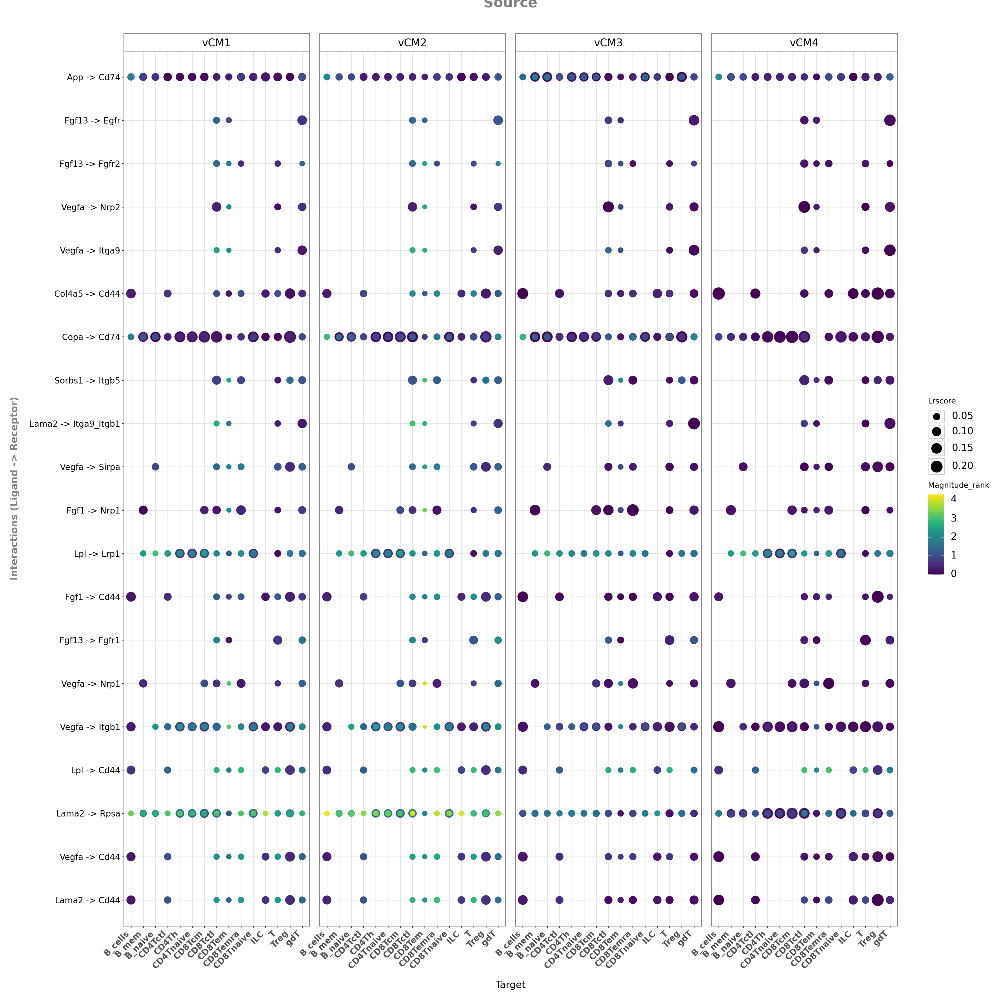

In [20]:
plot = li.pl.dotplot(
        cmc_lym,
        colour='magnitude_rank',
        size='lrscore',
        inverse_size=True,
        inverse_colour=True,
        source_labels=['vCM1', 'vCM2', 'vCM3', 'vCM4'],
        target_labels=['CD4Tnaive', 'CD8Tnaive', 'CD4Th', 'CD8Tctl', 'B_naive', 'CD8Tcm', 'B_cells', 'CD8Temra', 'B_mem', 'T', 'Treg', 'CD4Tctl', 'gdT', 'ILC', 'CD8Tem'],
        top_n= 20,
        orderby='magnitude_rank',
        filter_fun=lambda x: x['spec_weight'] <= 0.01,
        orderby_ascending=True
    )
    
plot += theme(
        axis_text_y=element_text(size=12),  
        axis_title_y=element_text(size=14),  
        axis_title_x=element_text(size=14),  
        axis_text_x=element_text(size=12, angle=45, ha='right'), 
        plot_title=element_text(size=20),  
        figure_size=(20, 20)
    )
    
plot.save(f'./cmc_lym/cmc_lym_ccc.png', limitsize=False)
plot

The plot is based on lrscore and magnitude rank .The interaction with large dot size and dark(blue) colour indicates significance as high lrscore and low rank are preferred.

Note that interactiuons are filtered based on function given, i.e., having specificity weight < 0.01 as low rank indicates high specificity

#### Steps

1. Consider our liana results to a variable and obtain unique samples from it
2. Create a output directory if it not exists
3. Define desired source and target labels
4. Create a for loop for looping over individual sample data
5. A try, exception loop is created to handle errors in soruce and target labels missing
6. Filter the data for the current sample and the filter source and targets available
7. Use filtered source and targets for plotting if available, else skip sample by printing
8. Plot sample based on magnituderank, lrscore
9. Customize plot adn save

In [21]:
liana_res = cmc_lym.uns['liana_res']
unique_samples = liana_res['sample'].unique()

output_dir = './cmc_lym/sample_plots'
os.makedirs(output_dir, exist_ok=True)

source_labels = ['vCM1', 'vCM2', 'vCM3', 'vCM4']
target_labels = ['CD4Tnaive', 'CD8Tnaive', 'CD4Th', 'CD8Tctl', 'B_naive', 'CD8Tcm', 'B_cells', 'CD8Temra', 'B_mem', 'T', 'Treg', 'CD4Tctl', 'gdT', 'ILC', 'CD8Tem']

for sample in unique_samples:
    try:
        sample_data = liana_res[liana_res['sample'] == sample]

        available_sources = sample_data['source'].unique()
        available_targets = sample_data['target'].unique()
        
        filtered_sources = [label for label in source_labels if label in available_sources]
        filtered_targets = [label for label in target_labels if label in available_targets]

        if not filtered_sources or not filtered_targets:
            print(f"Skipping sample {sample} due to no available sources or targets.")
            continue

        plot = li.pl.dotplot(
            liana_res=sample_data,
            colour='magnitude_rank',
            size='lrscore',
            inverse_size=True,
            inverse_colour=True,
            source_labels=filtered_sources,
            target_labels=filtered_targets,
            top_n=20,
            orderby='magnitude_rank',
            filter_fun=lambda x: x['spec_weight'] <= 0.01,
            orderby_ascending=True
        )
        
        plot += theme(
            axis_text_y=element_text(size=12),
            axis_title_y=element_text(size=14),
            axis_title_x=element_text(size=14),
            axis_text_x=element_text(size=12, angle=45, ha='right'),
            plot_title=element_text(size=20, label=f"Interactions for Sample: {sample}"),
            figure_size=(20, 20)
        )
        
        plot_path = os.path.join(output_dir, f'{sample}_ccc.png')
        plot.save(plot_path, limitsize=False)

    except Exception as e:
        print(f"Skipping sample {sample} due to error: {e}")


In [22]:
cmc_lym.write_h5ad('../data/cmc_lym_ccc_added.h5ad')

In [23]:
cmc_lym = sc.read_h5ad('../data/cmc_lym_ccc_added.h5ad')
cmc_lym

AnnData object with n_obs × n_vars = 67957 × 16060
    obs: 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels'
    uns: 'liana_res'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

# Tensor-Cell2cell


To find the variable CCC patterns across samples

## Building Tensor

#### Steps

1. Arranging samples in desired way
2. Adding them back to sample obs and arranging it properly
3. Sorting data based on sample

In [24]:
sorted_samples = ['A9_2', 'A10_2', 'A11_2','A12_2','B1_2', 'B2_2']
cmc_lym.obs['sample'] = pd.Categorical(cmc_lym.obs['sample'], categories=sorted_samples, ordered=True)
cmc_lym.obs = cmc_lym.obs.sort_values('sample')

In [25]:
cmc_lym.obs

,seed_labels,donor,cell_states,sample,cell_source,genotype,cell_type,n_counts,n_genes,percent_mito,...,pct_counts_mt,total_counts_ribo,pct_counts_ribo,percent_mt2,percent_chrY,XIST-counts,S_score,G2M_score,_scvi_batch,_scvi_labels
AGGATCTCAGCCTTCT-1-A9_2,CD4Th,A9_2,NaN,A9_2,HIRI-Nuclei,WT,CD4Th,16259.988615,2830.0,NaN,...,6.060606,85.0,1.609848,0.060606,0.075758,0.0,1.671930,2.239979,0.0,34.0
TGGCGTGCACGTTCGG-1-A9_2,vCM1,A9_2,NaN,A9_2,HIRI-Nuclei,WT,vCM1,8155.088937,1236.0,NaN,...,0.000000,1.0,0.039154,0.000000,0.117463,0.0,-0.280260,-0.160730,0.0,1.0
TCCTCGATCTGGAGAG-1-A9_2,vCM4,A9_2,NaN,A9_2,HIRI-Nuclei,WT,vCM4,6320.849973,940.0,NaN,...,4.401089,67.0,3.039927,0.044011,0.000000,0.0,-0.148282,-0.039985,0.0,0.0
CATAAGCAGTAGCAAT-1-A9_2,vCM1,A9_2,NaN,A9_2,HIRI-Nuclei,WT,vCM1,6856.855477,1024.0,NaN,...,0.166459,2.0,0.083229,0.001665,0.000000,0.0,-0.044481,0.176638,0.0,1.0
TCCCAGTAGCACCCAC-1-A9_2,vCM3,A9_2,NaN,A9_2,HIRI-Nuclei,WT,vCM3,8114.514163,1225.0,NaN,...,4.671717,75.0,3.156566,0.046717,0.126263,0.0,0.119925,0.094179,0.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TCCCACATCATCACAG-1-B2_2,NK,B2_2,NaN,B2_2,HIRI-Nuclei,MdxSCID,NK,1822.082963,211.0,NaN,...,26.353791,24.0,4.332130,0.263538,0.000000,0.0,-0.019449,0.000000,16.0,34.0
CTAGACATCATCACTT-1-B2_2,NK,B2_2,NaN,B2_2,HIRI-Nuclei,MdxSCID,NK,1768.952604,205.0,NaN,...,26.593807,12.0,2.185792,0.265938,0.000000,0.0,-0.019391,0.146109,16.0,34.0
TCATACTAGCCTCAAT-1-B2_2,NK,B2_2,NaN,B2_2,HIRI-Nuclei,MdxSCID,NK,1929.532959,226.0,NaN,...,26.863085,24.0,4.159445,0.268631,0.000000,0.0,-0.038485,0.000000,16.0,34.0
GGGTTATCATGTACGT-1-B2_2,NK,B2_2,NaN,B2_2,HIRI-Nuclei,MdxSCID,NK,1941.983196,228.0,NaN,...,42.810458,21.0,3.431373,0.428105,0.000000,0.0,0.176737,-0.068571,16.0,34.0


Clearly mention all the variables from uns as defaults may not give accurate results for analysis

how='outer' and outer_fraction=1/3 includes interactions present in at least one-third of the samples, 

In [26]:
tensor = li.multi.to_tensor_c2c(liana_res=cmc_lym.uns['liana_res'],
                                sample_key='sample', 
                                source_key='source', 
                                target_key='target',
                                ligand_key='ligand_complex', 
                                receptor_key='receptor_complex', 
                                score_key='magnitude_rank', 
                                inverse_fun=lambda x: 1 - x, 
                                how='outer', 
                                outer_fraction=1/3., 
                                context_order=sorted_samples, 
                                )
tensor

100%|██████████| 6/6 [00:07<00:00,  1.21s/it]


In [27]:
tensor.tensor.shape

torch.Size([6, 899, 18, 18])

In [28]:
c2c.io.export_variable_with_pickle(tensor, "tensor_cmc_lym.pkl")

tensor_cmc_lym.pkl  was correctly saved.


## Building Metadata

##### Steps

1. Sort data by samples and set the index to samples and add column genotype
2. Create a dictionary mapping samples to genotypes
3. Add the metadata to tensor. here only first one is added and others are none as we dont have metadata for other dimensions (source cells, target cells, ligand-receptor pairs) 

In [29]:
context_dict = cmc_lym.obs.sort_values(by='sample') \
                        .set_index('sample')['genotype'] \
                        .to_dict()

In [30]:
dimensions_dict = [context_dict, None, None, None]
meta_tensor = c2c.tensor.generate_tensor_metadata(interaction_tensor=tensor,
                                                  metadata_dicts=dimensions_dict,
                                                  fill_with_order_elements=True
                                                 )

In [31]:
meta_tensor

[  Element Category
 0    A9_2       WT
 1   A10_2       WT
 2   A11_2      Mdx
 3   A12_2      Mdx
 4    B1_2  MdxSCID
 5    B2_2  MdxSCID,
              Element               Category
 0        Actr2^Adrb2  Ligand-Receptor Pairs
 1         Actr2^Ldlr  Ligand-Receptor Pairs
 2           Ada^Dpp4  Ligand-Receptor Pairs
 3         Adam10^Axl  Ligand-Receptor Pairs
 4       Adam10^Cadm1  Ligand-Receptor Pairs
 ..               ...                    ...
 894  Wnt2b^Fzd6_Lrp5  Ligand-Receptor Pairs
 895  Wnt2b^Fzd6_Lrp6  Ligand-Receptor Pairs
 896  Wnt5b^Fzd6_Lrp5  Ligand-Receptor Pairs
 897  Wnt5b^Fzd6_Lrp6  Ligand-Receptor Pairs
 898      Ybx1^Notch1  Ligand-Receptor Pairs
 
 [899 rows x 2 columns],
       Element   Category
 0     B_cells    B_cells
 1       B_mem      B_mem
 2     B_naive    B_naive
 3     CD4Tctl    CD4Tctl
 4       CD4Th      CD4Th
 5   CD4Tnaive  CD4Tnaive
 6      CD8Tcm     CD8Tcm
 7     CD8Tctl    CD8Tctl
 8    CD8Temra   CD8Temra
 9   CD8Tnaive  CD8Tnaive
 10   

In [32]:
c2c.io.export_variable_with_pickle(meta_tensor, "tensor_metadata_cmc_lym.pkl")

tensor_metadata_cmc_lym.pkl  was correctly saved.


## Tensor-cell2cell Factorization

### Global analysis

Running Elbow Analysis


  0%|          | 0/25 [00:00<?, ?it/s]

100%|██████████| 25/25 [02:19<00:00,  5.59s/it]


The rank at the elbow is: 3
Running Tensor Factorization
Generating Outputs
Loadings of the tensor factorization were successfully saved into ./cmc_lym/Loadings.xlsx
CPU times: user 2min 22s, sys: 1.15 s, total: 2min 23s
Wall time: 2min 23s


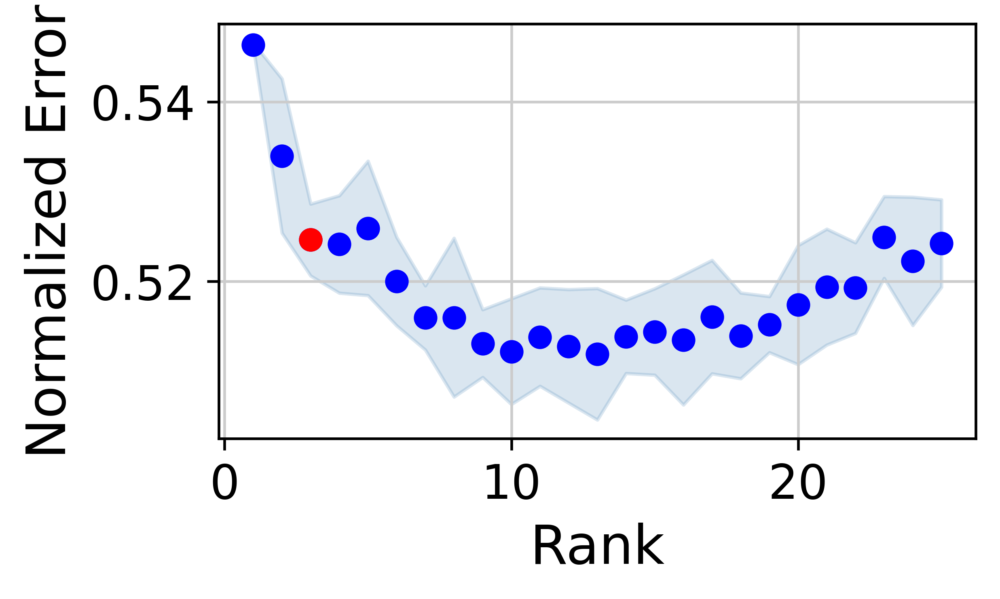

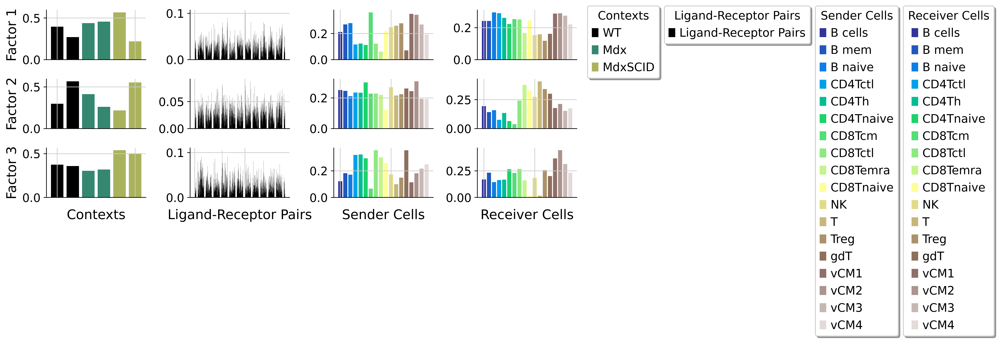

In [33]:
%%time
tensor2 = c2c.analysis.run_tensor_cell2cell_pipeline(tensor,
                                                    meta_tensor,
                                                    copy_tensor=True, 
                                                    rank= None,
                                                    tf_optimization='regular', 
                                                    random_state=0, 
                                                    device=device,
                                                    cmaps= ["gist_earth", "gray", "terrain", "terrain" ], 
                                                    output_fig=True,
                                                    output_folder= './cmc_lym',
                                                    backend='pytorch'
                                                    )

We dont know how many factors are optiaml and significant to represent the structure of our data, hence we use elbow method for detection. The elbow method identifies the optimal number of factors in a model by plotting Nomalized/reconstruction error against the number of factors and looks for a point where the error decrease slows significantly. This "elbow" point indicates a good balance between model complexity and fit, helping to avoid overfitting.

Heatmaps: Display the magnitude of interactions between sender and receiver cells, showing how strongly different ligand-receptor pairs interact across various contexts


In [34]:
meta_tensor2 = c2c.tensor.generate_tensor_metadata(interaction_tensor=tensor2,
                                                  metadata_dicts=dimensions_dict,
                                                  fill_with_order_elements=True
                                                 )

In [35]:
c2c.io.export_variable_with_pickle(tensor2, "tensor_factorized_cmc_lym.pkl")
c2c.io.export_variable_with_pickle(meta_tensor2, "tensor_factorized_metadata_cmc_lym.pkl")

tensor_factorized_cmc_lym.pkl  was correctly saved.
tensor_factorized_metadata_cmc_lym.pkl  was correctly saved.


### Factorization Results

In [36]:
tensor2 = c2c.io.load_variable_with_pickle("tensor_factorized_cmc_lym.pkl")
meta_tensor2 = c2c.io.load_variable_with_pickle("tensor_factorized_metadata_cmc_lym.pkl")

In [37]:
factors = tensor2.factors

In [38]:
factors.keys()

odict_keys(['Contexts', 'Ligand-Receptor Pairs', 'Sender Cells', 'Receiver Cells'])

In [39]:
factors['Contexts'].head()

,Factor 1,Factor 2,Factor 3
A9_2,0.395959,0.297371,0.373833
A10_2,0.270584,0.566458,0.357675
A11_2,0.437990,0.412916,0.303399
A12_2,0.456577,0.260399,0.318913
B1_2,0.567146,0.216901,0.538645


In [40]:
factors_df = pd.DataFrame(factors['Contexts'])
factors_df

,Factor 1,Factor 2,Factor 3
A9_2,0.395959,0.297371,0.373833
A10_2,0.270584,0.566458,0.357675
A11_2,0.437990,0.412916,0.303399
A12_2,0.456577,0.260399,0.318913
B1_2,0.567146,0.216901,0.538645
B2_2,0.219198,0.552578,0.498420


## Downstream Analyses of Factor Loadings

### Visualization of factor contributions

#### Steps

1. Specify the samples to subset and subest the factors dataframe
2. Create an output folder for plots
3. Setup heatmap plotting
4. Create a for loop to generate plot per factor
5. Add customizations and save them

<Figure size 3000x1800 with 0 Axes>

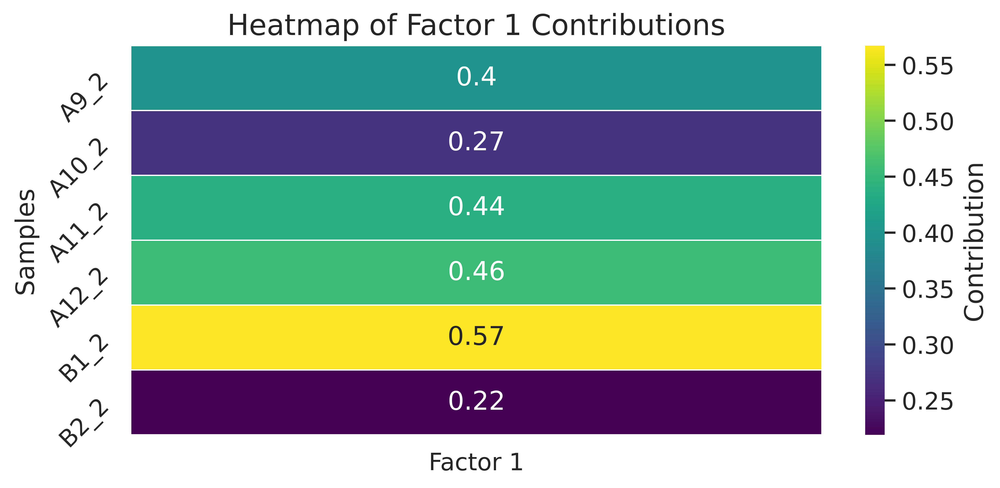

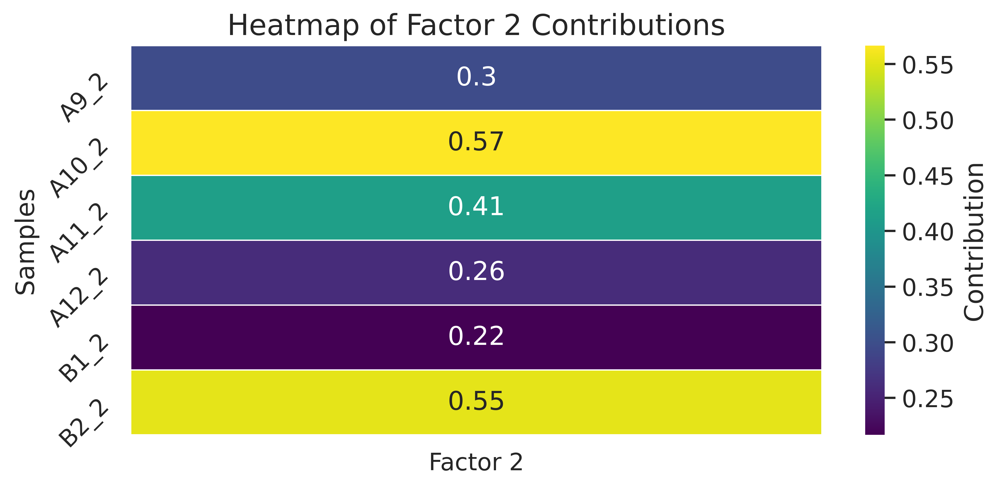

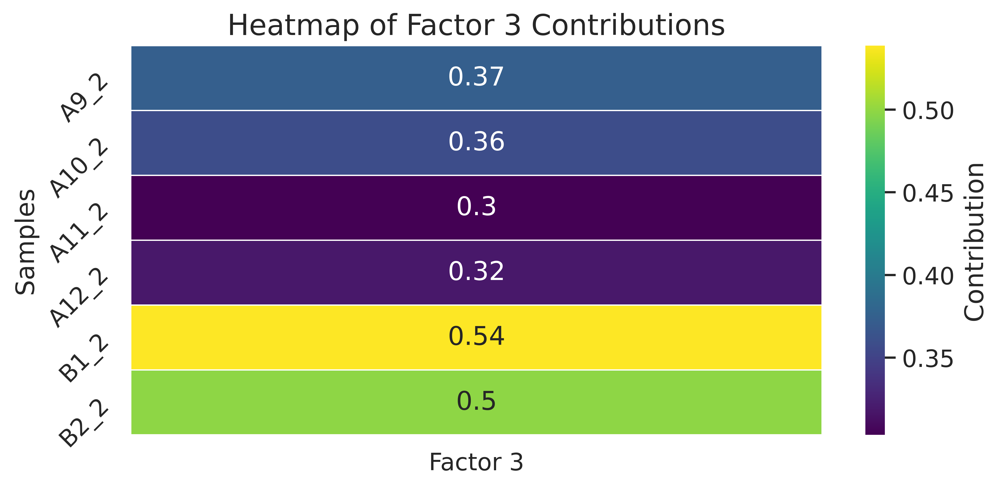

In [41]:
selected_samples = ['A9_2', 'A10_2', 'A11_2', 'A12_2', 'B1_2', 'B2_2']  
subset_factors = factors_df.loc[selected_samples]

output_dir = './cmc_lym/heatmap_plots'
os.makedirs(output_dir, exist_ok=True)

plt.figure(figsize=(10, 6))
sns.set(font_scale=1.2)

for factor in subset_factors.columns:
    plt.figure(figsize=(8, 4))
    sns.heatmap(subset_factors[[factor]], annot=True, cmap='viridis', cbar_kws={'label': 'Contribution'}, linewidths=.5)
    plt.title(f'Heatmap of {factor} Contributions', fontsize=16)
    plt.ylabel('Samples' ,fontsize=14)
    plt.yticks(rotation=45)
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f'{factor}_heatmap.png'), dpi=300)
    plt.show()

<Figure size 3000x1800 with 0 Axes>

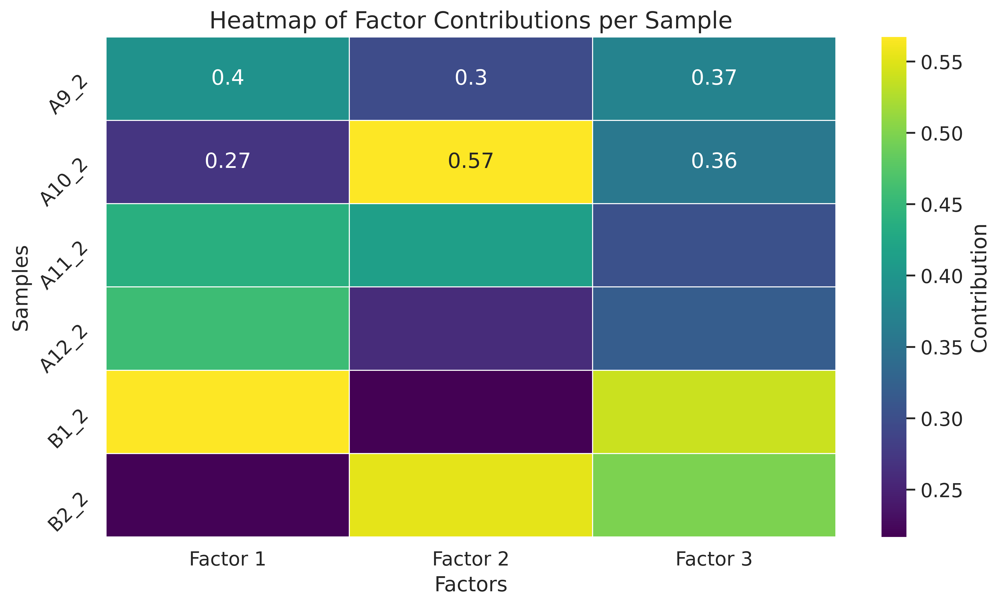

In [42]:
plt.figure(figsize=(10, 6))
sns.set(font_scale=1.2)


plt.figure(figsize=(10, 6))
sns.heatmap(subset_factors, annot=True, cmap='viridis', cbar_kws={'label': 'Contribution'}, linewidths=.5)
plt.title('Heatmap of Factor Contributions per Sample', fontsize=16)
plt.ylabel('Samples', fontsize=14)
plt.xlabel('Factors', fontsize=14)
plt.yticks(rotation=45)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, 'all_factors_heatmap.png'), dpi=300)
plt.show()

### Stastical testing

In [43]:
context_dict
context_dict = cmc_lym.obs.sort_values(by='sample') \
                        .set_index('sample')['genotype'] \
                        .to_dict()

context_dict

{'A9_2': 'WT',
 'A10_2': 'WT',
 'A11_2': 'Mdx',
 'A12_2': 'Mdx',
 'B1_2': 'MdxSCID',
 'B2_2': 'MdxSCID'}

In [44]:
factors

OrderedDict([('Contexts',
                     Factor 1  Factor 2  Factor 3
              A9_2   0.395959  0.297371  0.373833
              A10_2  0.270584  0.566458  0.357675
              A11_2  0.437990  0.412916  0.303399
              A12_2  0.456577  0.260399  0.318913
              B1_2   0.567146  0.216901  0.538645
              B2_2   0.219198  0.552578  0.498420),
             ('Ligand-Receptor Pairs',
                               Factor 1  Factor 2  Factor 3
              Actr2^Adrb2      0.007807  0.029953  0.028416
              Actr2^Ldlr       0.010604  0.025787  0.014653
              Ada^Dpp4         0.058591  0.043012  0.016872
              Adam10^Axl       0.027110  0.019602  0.025972
              Adam10^Cadm1     0.027571  0.021497  0.009713
              ...                   ...       ...       ...
              Wnt2b^Fzd6_Lrp5  0.052781  0.040380  0.009247
              Wnt2b^Fzd6_Lrp6  0.048394  0.017967  0.020933
              Wnt5b^Fzd6_Lrp5  0.022928  0.

In [45]:
factors['Contexts'].describe()

,Factor 1,Factor 2,Factor 3
count,6.000000,6.000000,6.000000
mean,0.391242,0.384437,0.398481
std,0.127731,0.150498,0.097240
min,0.219198,0.216901,0.303399
25%,0.301928,0.269642,0.328604
50%,0.416974,0.355144,0.365754
75%,0.451931,0.517663,0.467273
max,0.567146,0.566458,0.538645


#### Data distribution

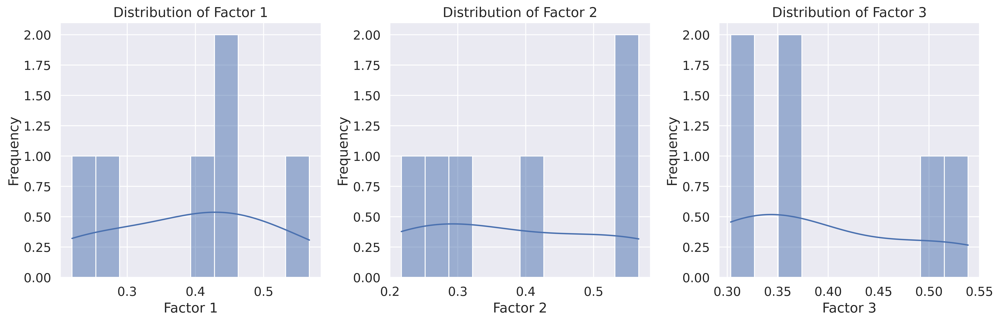

In [46]:
factors_visualization = ['Factor 1', 'Factor 2', 'Factor 3']

plt.figure(figsize=(15, 5))
for i, factor in enumerate(factors_visualization):
    plt.subplot(1, 3, i + 1)
    sns.histplot(factors_df[factor], bins=10, kde=True)  
    plt.title(f'Distribution of {factor}')
    plt.xlabel(factor)
    plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

In [47]:
for factor in factors_df.columns:
    stat, p = shapiro(factors_df[factor])
    print(f'{factor}: Statistics={stat}, p-value={p}')
    if p > 0.05:
        print(f'{factor} looks Gaussian (fail to reject H0)')
    else:
        print(f'{factor} does not look Gaussian (reject H0)')


Factor 1: Statistics=0.9586007475522003, p-value=0.8088941343760421
Factor 1 looks Gaussian (fail to reject H0)
Factor 2: Statistics=0.8871681801722527, p-value=0.3036150488464838
Factor 2 looks Gaussian (fail to reject H0)
Factor 3: Statistics=0.8722521756593287, p-value=0.23533082153019919
Factor 3 looks Gaussian (fail to reject H0)


If the p-value from the Shapiro-Wilk test is greater than 0.05, you fail to reject the null hypothesis, meaning the data is likely normally distributed.

For normally distributed data, t-test is used and for data which is not normally distributed, the Mann-Whitney-Wilcoxon test is used

#### Boxplots to statistically compare group of samples

In [48]:
c2c.plotting.context_boxplot(context_loadings=factors['Contexts'],
                                         metadict=context_dict,
                                         nrows=4,
                                         figsize=(10, 25),
                                         statistical_test='t-test_ind',
                                         pval_correction='fdr_bh',
                                         cmap='Greys',
                                         verbose=True,
                                         title_size=12,
                                         axis_label_size=12,
                                         filename = './cmc_lym/stat_tests_lym.png')

plt.show()

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Mdx vs. WT: t-test independent samples with Benjamini-Hochberg correction, P_val:2.138e-01 t=1.799e+00
WT vs. MdxSCID: t-test independent samples with Benjamini-Hochberg correction, P_val:7.767e-01 t=-3.239e-01


Mdx vs. MdxSCID: t-test independent samples with Benjamini-Hochberg correction, P_val:7.855e-01 t=3.106e-01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Mdx vs. WT: t-test independent samples with Benjamini-Hochberg correction, P_val:6.007e-01 t=-6.159e-01
WT vs. MdxSCID: t-test independent samples with Benjamini-Hochberg correction, P_val:8.468e-01 t=2.193e-01
Mdx vs. MdxSCID: t-test independent samples with Benjamini-Hochberg correction, P_val:8.186e-01 t=-2.608e-01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Mdx vs. WT: t-test independent samples with Benjamini-Hochberg correction, P_val:3.960e-02 t=-4.875e+00
WT vs. MdxSCID: t-test independent samples with Benjamini-Hochberg correction, P_val:1.954e-02 t=-7.049e+0

It is observed that via t-test we got to know that Factor 3 has significant differences in between genotypes. 

In [49]:
c2c.plotting.context_boxplot(context_loadings=factors['Contexts'],
                                         metadict=context_dict,
                                         nrows=4,
                                         figsize=(10, 25),
                                         statistical_test='Mann-Whitney',
                                         pval_correction='benjamini-hochberg',
                                         cmap='Greys',
                                         verbose=True,
                                         title_size=12,
                                         axis_label_size=12)

plt.show()

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Mdx vs. WT: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:3.333e-01 U_stat=4.000e+00
WT vs. MdxSCID: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.000e+00 U_stat=2.000e+00
Mdx vs. MdxSCID: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.000e+00 U_stat=2.000e+00
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Mdx vs. WT: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:6.667e-01 U_stat=1.000e+00
WT vs. MdxSCID: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:6.667e-01 U_stat=3.000e+00
Mdx vs. MdxSCID: Mann-Whitney-Wilco

Mann-Whitneey is very strict and it gave out no significant results which means that the groups doesnt have any significant differences in patterns shown by them based on genotype.

### Finding Correlation between genotypes

We first define the ranking of the severity, where higher values represent the worst severity.

In [50]:
def severity_rank(x):
    if x == 'WT':
        ranking = 1
    elif x == 'MdxSCID':
        ranking = 2
    elif x == 'Mdx':
        ranking = 3
    return ranking

We generate a dataframe with the same indexes as the dataframe containing the loadings, then assign those rankings here

In [51]:
sev_rank = pd.DataFrame(index=factors['Contexts'].index)
sev_rank['Severity-Ranking'] = [severity_rank(context_dict[idx]) for idx in factors['Contexts'].index]
sev_rank.head

<bound method NDFrame.head of        Severity-Ranking
A9_2                  1
A10_2                 1
A11_2                 3
A12_2                 3
B1_2                  2
B2_2                  2>

Number of factors from the tensor decomposition

In [52]:
nfactors = factors['Contexts'].shape[1]

Spearman correlation

In [53]:
for i in range(1, nfactors+1):
    factor = 'Factor {}'.format(i)
    print(factor, scipy.stats.spearmanr(factors['Contexts'][factor],
                                sev_rank['Severity-Ranking']))


Factor 1 SignificanceResult(statistic=0.4780914437337575, pvalue=0.33750185654036463)
Factor 2 SignificanceResult(statistic=-0.35856858280031817, pvalue=0.4851979632652574)
Factor 3 SignificanceResult(statistic=-0.4780914437337575, pvalue=0.33750185654036463)


### Heatmaps

#### Cluster samples by their importance across factors

##### Steps

1. Genwerate color accordingg to severity of sample
2. Map the colors to sample names
3. Create a datafram,e woith the color info

In [54]:
condition_colors = c2c.plotting.aesthetics.get_colors_from_labels(['WT', 'MdxSCID','Mdx' ],
                                                                  cmap='RdYlBu')


color_dict = {k : condition_colors[v] for k, v in context_dict.items()}


col_colors = pd.Series(color_dict)
col_colors = col_colors.to_frame()
col_colors.columns = ['Genotype colors']
col_colors.head()

,Genotype colors
A9_2,"(0.6470588235294118, 0.0, 0.14901960784313725,..."
A10_2,"(0.6470588235294118, 0.0, 0.14901960784313725,..."
A11_2,"(0.7398692810457519, 0.884967320261438, 0.9333..."
A12_2,"(0.7398692810457519, 0.884967320261438, 0.9333..."
B1_2,"(0.9934640522875817, 0.7477124183006535, 0.441..."


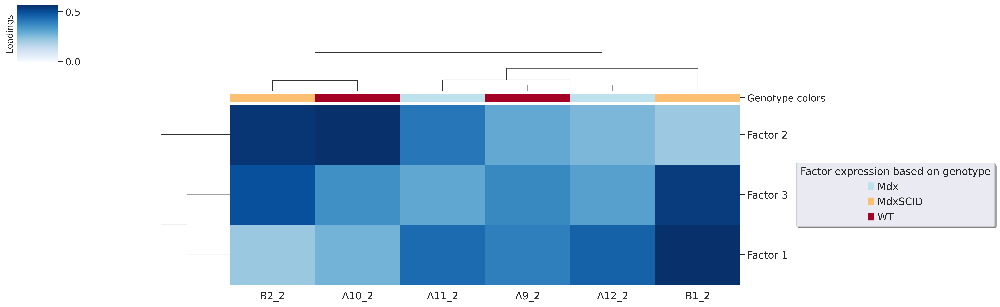

In [55]:
sample_cm = c2c.plotting.loading_clustermap(factors['Contexts'],
                                            use_zscore=False, 
                                            col_colors=col_colors, 
                                            figsize=(16, 6),
                                            dendrogram_ratio=0.3,
                                            cbar_fontsize=12,
                                            tick_fontsize=14,
                                            filename='./cmc_lym/Clustermap-Contexts.pdf'
                                           )

plt.sca(sample_cm.ax_heatmap)
legend = c2c.plotting.aesthetics.generate_legend(color_dict=condition_colors,
                                                 bbox_to_anchor=(1.1, 0.5), 
                                                 title='Factor expression based on genotype'
                                                )

Here samples are grouped by the importance that each factor has in relation to the other samples. This captures combinations of related factors that explain similarities and differences at a sample-specific resolution

#### Cluster LR pairs by their importance across factors

In [56]:
lr_cm = c2c.plotting.loading_clustermap(factors['Ligand-Receptor Pairs'],
                                        loading_threshold=0.05, 
                                        use_zscore=False, 
                                        figsize=(28, 8),
                                        filename='./cmc_lym/Clustermap-LRs.pdf',
                                        row_cluster=False 
                                       )

LR pairs are grouped according to how important they for one factor versus the others. This can give an idea of the molecular mechanisms that are crucial in each communication pattern.

#### Cluster sender-receiver pairs for an specific factor

To determine the cellular interactions underlying specific factor(Factor 3) . 

We define its Loading Product between senders and receiver cells  which represents the joint importance of the cell-cell pair

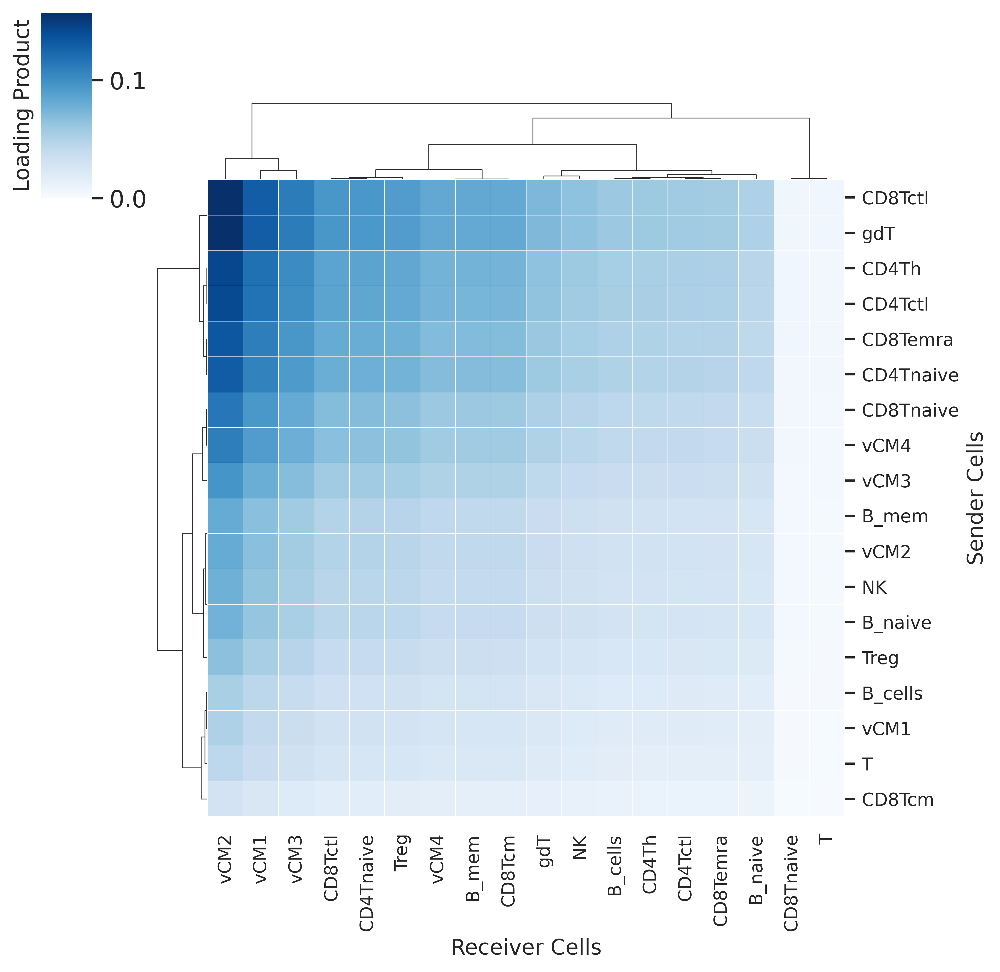

In [57]:
selected_factor = 'Factor 3'
loading_product = c2c.analysis.tensor_downstream.get_joint_loadings(factors,
                                                                    dim1='Sender Cells',
                                                                    dim2='Receiver Cells',
                                                                    factor=selected_factor,
                                                                   )
lprod_cm = c2c.plotting.loading_clustermap(loading_product.T, 
                                           use_zscore=False, 
                                           figsize=(8, 8),
                                           filename='./cmc_lym/Clustermap-CC-Pairs.pdf',
                                           cbar_label='Loading Product',
                                          )

#### Evaluation of sender-receiver pair and LR pairs used in a specific factor

In [58]:
sns.set(font_scale=0.5)

lr_cell_product = c2c.analysis.tensor_downstream.get_lr_by_cell_pairs(
    factors,
    lr_label='Ligand-Receptor Pairs',
    sender_label='Sender Cells',
    receiver_label='Receiver Cells',
    order_cells_by='receivers',
    factor=selected_factor,
    cci_threshold=None, 
    lr_threshold=0.075 
)

lsr_prod_cm = c2c.plotting.loading_clustermap(
    lr_cell_product,
    use_zscore=False, 
    figsize=(12, 28),
    filename='./cmc_lym/Clustermap-LR-CC-Pairs.pdf',
    cbar_label='Loading Product',
    yticklabels=1  
)

plt.setp(lsr_prod_cm.ax_heatmap.yaxis.get_majorticklabels(), fontsize=6)

lsr_prod_cm.savefig('./cmc_lym/Clustermap-LR-CC-Pairs.pdf')

1. **Dcn^Egfr**: Decorin (Dcn) interacts with the epidermal growth factor receptor (Egfr), potentially modulating cell proliferation and differentiation.
  
2. **Fgf13^Fgfr2**: Fibroblast growth factor 13 (Fgf13) binds to fibroblast growth factor receptor 2 (Fgfr2), playing a role in neuronal development and function.
  
3. **Apoe^Vldlr**: Apolipoprotein E (Apoe) interacts with very low-density lipoprotein receptor (Vldlr), influencing lipid metabolism and neuronal repair.
  
4. **Col1a2^Cd36**: Collagen type I alpha 2 (Col1a2) interacts with cluster of differentiation 36 (Cd36), potentially affecting tissue remodeling and inflammation.
  
5. **Thbs1^Cd36**: Thrombospondin-1 (Thbs1) binds to Cd36, involved in cell adhesion and migration during wound healing.
  
6. **Apoe^Lrp1**: Apoe binds to low-density lipoprotein receptor-related protein 1 (Lrp1), regulating lipid uptake and cholesterol homeostasis.
  
7. **Apoe^Lrp6**: Apoe interacts with low-density lipoprotein receptor-related protein 6 (Lrp6), potentially influencing Wnt signaling and lipid metabolism.
  
8. **Ado^Adora2a**: Adenosine (Ado) activates adenosine receptor A2A (Adora2a), modulating anti-inflammatory responses and neuroprotection.
  
9. **S100a1^Ryr2**: S100 calcium-binding protein A1 (S100a1) interacts with ryanodine receptor 2 (Ryr2), regulating calcium signaling in cardiac muscle.
  
10. **Mfng^Notch1**: Manfng (Mfang) binds to Notch receptor 1 (Notch1), participating in cell fate determination and differentiation.
  
11. **Ado^Adora2b**: Adenosine interacts with adenosine receptor A2B (Adora2b), involved in modulating immune responses and inflammation.
  
12. **Col1a1^Cd36**: Collagen type I alpha 1 (Col1a1) binds to Cd36, influencing cellular responses to extracellular matrix components.
  
13. **F13a1^Itgb1**: Coagulation factor XIII A chain (F13a1) interacts with integrin beta-1 (Itgb1), potentially impacting cell adhesion and tissue repair.
  
14. **Dcn^Erbb4**: Decorin interacts with ErbB4, possibly regulating cell signaling pathways involved in development and cancer.
  
15. **Egf^Erbb4**: Epidermal growth factor (Egf) binds to ErbB4, promoting cell proliferation and differentiation through receptor tyrosine kinase signaling.
  
16. **Ltb^Cd40**: Lymphotoxin-beta (Ltb) interacts with CD40, modulating immune responses and inflammation.
  
17. **Apoe^Abca1**: Apoe binds to ATP-binding cassette transporter A1 (Abca1), promoting cholesterol efflux and HDL formation.
  
18. **Dcn^Tlr4**: Decorin interacts with Toll-like receptor 4 (Tlr4), potentially modulating immune responses and inflammation.
  
19. **Fgf13^Scn5a**: Fgf13 binds to sodium channel protein SCN5A (Scn5a), involved in cardiac conduction and rhythm regulation.
  
20. **App^Rpsa**: Amyloid precursor protein (App) interacts with receptor protein SA (Rpsa), which may influence neural signaling and synaptic function.

### Overall CCI potential: Network visualization of sender-receiver cell pairs

First obtain all networks of from sender and reciever cells and flatten the networks based on recievers

In [59]:
networks = c2c.analysis.tensor_downstream.get_factor_specific_ccc_networks(factors,
                                                                           sender_label='Sender Cells',
                                                                           receiver_label='Receiver Cells',
                                                                           )

In [60]:
network_by_factors = c2c.analysis.tensor_downstream.flatten_factor_ccc_networks(networks, orderby='receivers')
network_values = network_by_factors.values.flatten()

Plot histogram and highlight 90th percentile to use it as threshold

90th percentile threshold: 0.08503185734152793


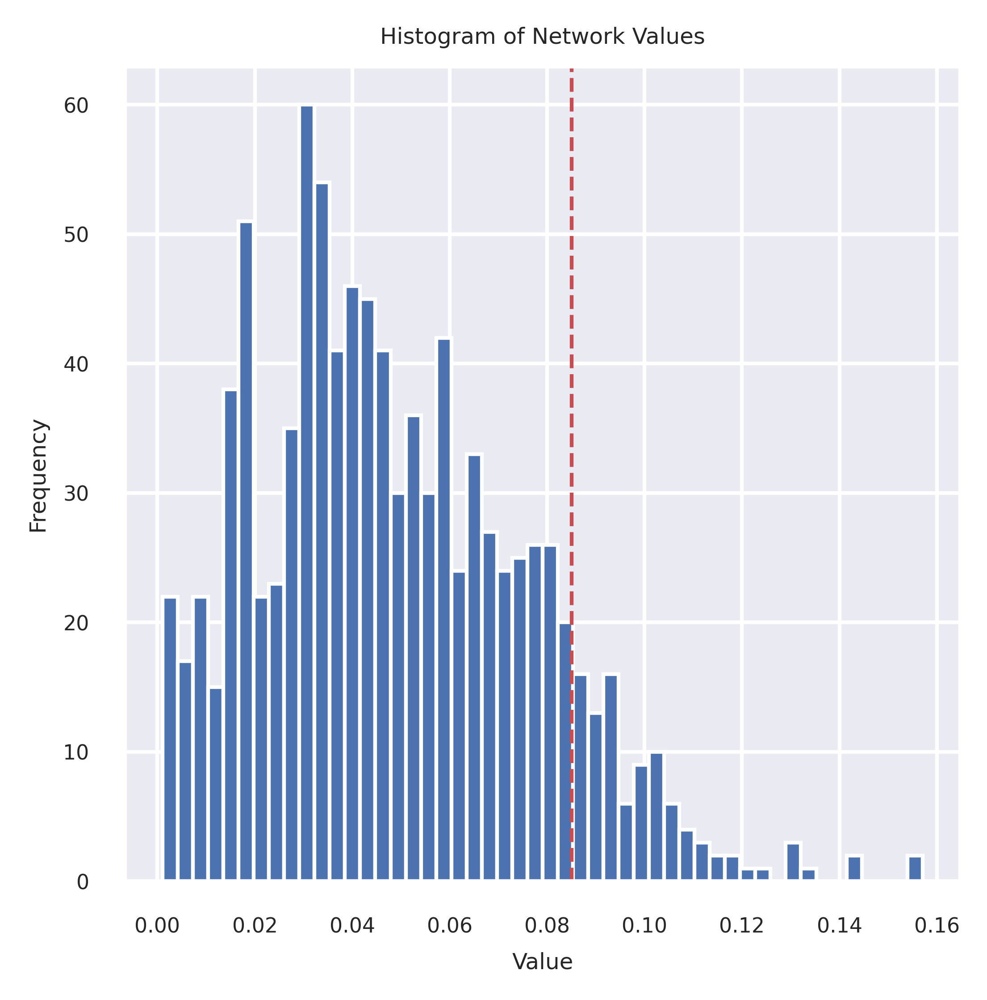

In [61]:
_ = plt.hist(network_values, bins=50)

threshold = np.percentile(network_values, 90)
print(f"90th percentile threshold: {threshold}")

plt.axvline(threshold, color='r', linestyle='dashed', linewidth=1)
plt.title('Histogram of Network Values')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.show()

In [62]:
threshold = 0.085 ##90th percentile of distribution

In [63]:
c2c.plotting.ccc_networks_plot(factors,
                               included_factors=['Factor 1', 'Factor 2', 'Factor 3'],
                               ccc_threshold=threshold, 
                               nrows=1,
                               panel_size=(16, 16),
                               filename='./cmc_lym/Factor-Networks.pdf',
                              )

(<Figure size 14400x4800 with 3 Axes>,
 array([<Axes: title={'center': 'Factor 1'}>,
        <Axes: title={'center': 'Factor 2'}>,
        <Axes: title={'center': 'Factor 3'}>], dtype=object))

### Gini coefficients of the factor-specific cell-cell communication

In [64]:
c2c.analysis.tensor_downstream.compute_gini_coefficients(factors,
                                                         sender_label='Sender Cells',
                                                         receiver_label='Receiver Cells'
                                                        ).sort_values('Gini')

,Factor,Gini
0,Factor 1,0.286236
1,Factor 2,0.303313
2,Factor 3,0.362951


The Gini coefficient quantifies the extent to which sender-receiver cell pairs differ within a factor according to their importance as measured by their loadings. It is used to measure the imbalance of communication for a given factor. It identifies whether a few cells are key for an identified pattern (low Gini coefficient) or whether the pattern corresponds to a general process that involves most of the cell types (high Gini coefficient)

We observe that the lowest Gini coefficient was obtained by factor 1, which seems to have more balanced cell loadings. Senders and/or receivers are more similar or homogeneous.

## Pathway Enrichment of LR loadings

Open the loadings obtained from the tensor factorization

In [65]:
factors = c2c.io.load_tensor_factors('./cmc_lym/Loadings.xlsx')

In [66]:
lr_pairs = li.resource.select_resource('mouseconsensus')
lr_pairs.head()

,ligand,receptor
31371,Dll1,Notch1
31372,Dll1,Notch2
31373,Dll1,Notch4
31374,Dll1,Notch3
31375,Nrg2,Erbb2_Erbb3


Generate a list with the LR pair names

In [67]:
lr_list = ['^'.join(row) for idx, row in lr_pairs.iterrows()]

### Gene set enrichment analysis

In [68]:
organism = 'mouse' 
pathwaydb = 'Reactome' 

##### Generate the LR-gene set that will be used for running GSEA

In [69]:
lr_set = c2c.external.generate_lr_geneset(lr_list,
                                          complex_sep='_',
                                          lr_sep='^',
                                          pathwaydb=pathwaydb,
                                          organism=organism,
                                          readable_name=True,
                                          output_folder='./cmc_lym'
                                          )

Extract LR loadings for each factor

In [70]:
lr_loadings = factors['Ligand-Receptor Pairs']

##### Run GSEA

In [71]:
%%time
pvals, scores, gsea_df = c2c.external.run_gsea(loadings=lr_loadings,
                                               lr_set=lr_set,
                                               output_folder='./cmc_lym',

                                              )

./cmc_lym already exists.


 33%|███▎      | 1/3 [00:00<00:01,  1.59it/s]

100%|██████████| 3/3 [00:02<00:00,  1.36it/s]

CPU times: user 3.03 s, sys: 2.29 s, total: 5.31 s
Wall time: 2.25 s


##### Enriched Pathways

In [72]:
gsea_df

,Factor,Term,NES,P-value,Adj. P-value
0,Factor 1,TOLL LIKE RECEPTOR CASCADES,1.784008,0.003115,0.068536
1,Factor 1,METABOLISM,1.454855,0.042708,0.554622
2,Factor 1,SIGNALING BY RECEPTOR TYROSINE KINASES,1.315885,0.051051,0.554622
3,Factor 1,ADAPTIVE IMMUNE SYSTEM,1.214354,0.206544,0.993994
4,Factor 1,INNATE IMMUNE SYSTEM,1.204304,0.153307,0.993994
...,...,...,...,...,...
61,Factor 3,CELL SURFACE INTERACTIONS AT THE VASCULAR WALL,0.724301,0.872490,0.993994
62,Factor 3,INTEGRIN CELL SURFACE INTERACTIONS,0.684447,0.967968,0.993994
63,Factor 3,NON INTEGRIN MEMBRANE ECM INTERACTIONS,0.653136,0.919110,0.993994
64,Factor 3,EXTRACELLULAR MATRIX ORGANIZATION,0.640211,0.993994,0.993994


- **NES (Normalized Enrichment Score)**: A score that shows how much a specific group of genes stands out in a list of genes.

- **P-value**: A number that tells you how likely it is that our results happened by chance.

- **Adj. P-value (Adjusted P-value)**: A number that helps correct for multiple correction tests, making it less likely to find false positives.

In [73]:
enriched_gsea_df = gsea_df[(gsea_df['Adj. P-value'] <= 0.05) & (gsea_df['NES'] >= 1)]
enriched_gsea_df

,Factor,Term,NES,P-value,Adj. P-value
22,Factor 2,METABOLISM,1.788136,0.001067,0.035219


In [74]:
depleted_gsea_df = gsea_df[(gsea_df['Adj. P-value'] <= 0.05) & (gsea_df['NES'] <=  1)]
depleted_gsea_df

,Factor,Term,NES,P-value,Adj. P-value
5,Factor 1,CELL SURFACE INTERACTIONS AT THE VASCULAR WALL,-1.189032,0.001,0.035219


In [75]:
gsea_df.to_csv('./cmc_lym/Enriched_pathways_cmc_lym.csv', index= False)

##### Visualization

In [76]:
with sns.axes_style("darkgrid"):
    dotplot = c2c.plotting.pval_plot.generate_dot_plot(pval_df=pvals,
                                                       score_df=scores,
                                                       significance=0.05, ##P value
                                                       xlabel='',
                                                       ylabel='{} Annotations'.format(pathwaydb),
                                                       cbar_title='Normalized Enrichment Score',
                                                       cmap='RdYlBu',
                                                       label_size=20,
                                                       title_size=20,
                                                       tick_size=12,
                                                       filename='./cmc_lym/GSEA_dotplot_cmc_lym.png'
                                                      )


### Footprint Enrichment

Footprint enrichment analysis build upon classic geneset enrichment analysis, as instead of considering the genes involved in a biological activity, they consider the genes affected by the activity, or in other words the genes that change downstream of said activity. we will use the PROGENy pathway resource to perform footprint enrichment analysis. PROGENy was built in a data-driven manner using perturbation and cancer lineage data , as a consequence it also assigns different importances or weights to each gene in its pathway genesets.

##### Load the PROGENy pathway resource

In [77]:
net = dc.get_progeny(organism='mouse', top=5000)

ImportError: cannot import name 'orthology' from 'pypath.utils' (/home/skolla/miniforge3/envs/liana_env/lib/python3.9/site-packages/pypath/utils/__init__.py)

In [ ]:
lr_progeny = li.rs.generate_lr_geneset(lr_pairs, net, lr_sep="^")
lr_progeny.head()

##### Run footprint enrichment analysis

In [ ]:
estimate, pvals =  dc.run_mlm(lr_loadings.transpose(),
                              lr_progeny,
                              source="source",
                              target="interaction",
                              use_raw=False)

In [ ]:
sns.clustermap(estimate, xticklabels=estimate.columns, cmap='coolwarm', z_score=4)
plt.savefig('./cmc_lym/PROGENy.pdf', dpi=300, bbox_inches='tight')

In [ ]:
selected_factors = ['Factor 1', 'Factor 2', 'Factor 3']

for factor in selected_factors:
    try:
        dc.plot_barplot(
            estimate,
            factor,
            vertical=True,
            cmap='coolwarm',
            save=f'./cmc_lym/PROGENy-{factor.replace(" ", "-")}.pdf'
        )
        print(f'Bar plot for {factor} saved successfully!')
    except Exception as e:
        print(f'An error occurred while generating the bar plot for {factor}: {e}')


From the plots above, we can see that the JAK-STAT pathway is active and highly active in Factor 5. Let’s see which ligand-receptor pairs are enriched in this pathway.

In [ ]:
pathway = 'JAK-STAT'
# loadings to long format
lr_loadings_long = lr_loadings.reset_index().melt(id_vars='index', var_name="Factor", value_name="Loadings").rename(columns={'index':'interaction'})
# join progeny weights and keep only NFkB pathway
lr_loadings_long = lr_loadings_long.merge(lr_progeny, on='interaction').query("source == '{}' and Factor == '{}'".format(pathway, selected_factor))
# add sign to the weights
lr_loadings_long['sign'] = lr_loadings_long['weight'].apply(lambda x: 'positive' if x > 0 else 'negative')
# keep only relevant interactions for labels
lr_loadings_long['relevant_interactions'] = lr_loadings_long.apply(lambda x: x['interaction'] if (x['Loadings'] > 0.025) and (x['weight'] > 2.5) else None, axis=1)
lr_loadings_long.head()

Plot the loadings for Factor 5 and weights of the JAK-STAT pathway

In [ ]:
(p9.ggplot(lr_loadings_long,
           p9.aes(x='weight', y='Loadings')) +
 p9.geom_smooth(method='lm') +
 p9.geom_point(p9.aes(colour='sign')) +
 p9.theme_bw() +
 p9.theme(legend_position='none') +
 p9.labs(title="{} | {}".format(pathway, selected_factor), x="PROGENy Weights", y="Loadings") +
 p9.scale_colour_manual(values=["royalblue", "red"]) +
 p9.geom_label(p9.aes(label='relevant_interactions'), size=8, nudge_y=0.01, nudge_x=0.01) +
 p9.xlim(-1, 8.5)
 )